In [192]:
import cv2 # pip3 install opencv-python
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw # pip3 install Pillow
import json
import os

In [17]:
rel_data_path = "../sample_data/"
test_name = "2020-03-11+15-04-20+NAB972-Seite+Rechts+Unten-_00053"

test_picture = Image.open(os.path.join(rel_data_path, test_name + ".jpg"))
with open(os.path.join(rel_data_path, test_name + ".json"), 'r') as f:
    test_labels = json.load(f)

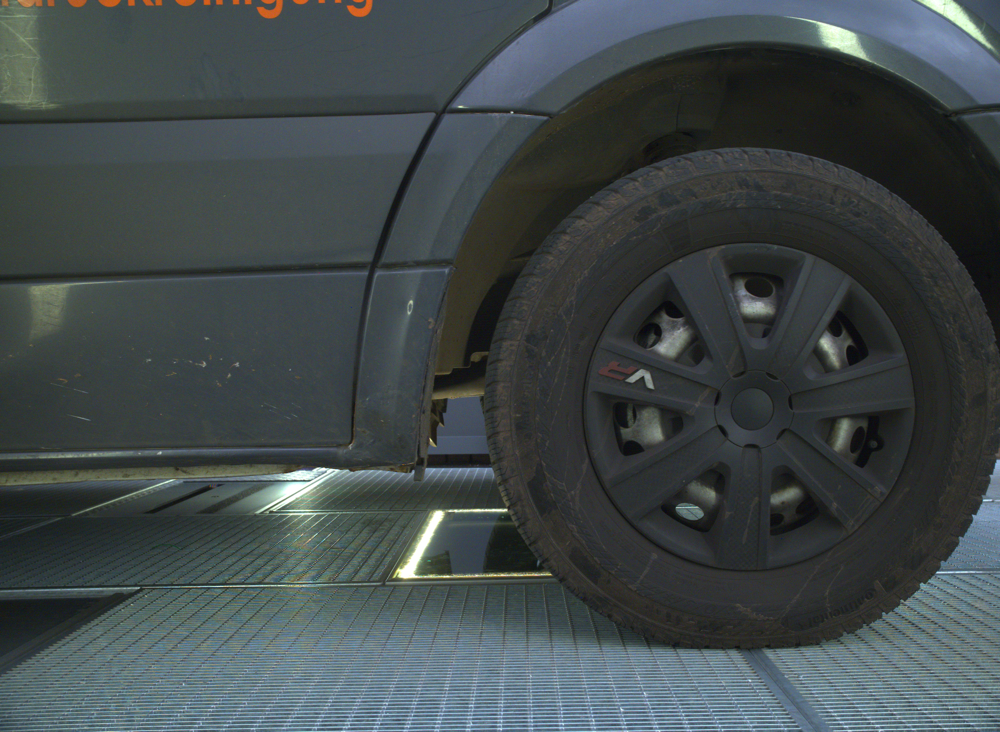

In [18]:
test_picture

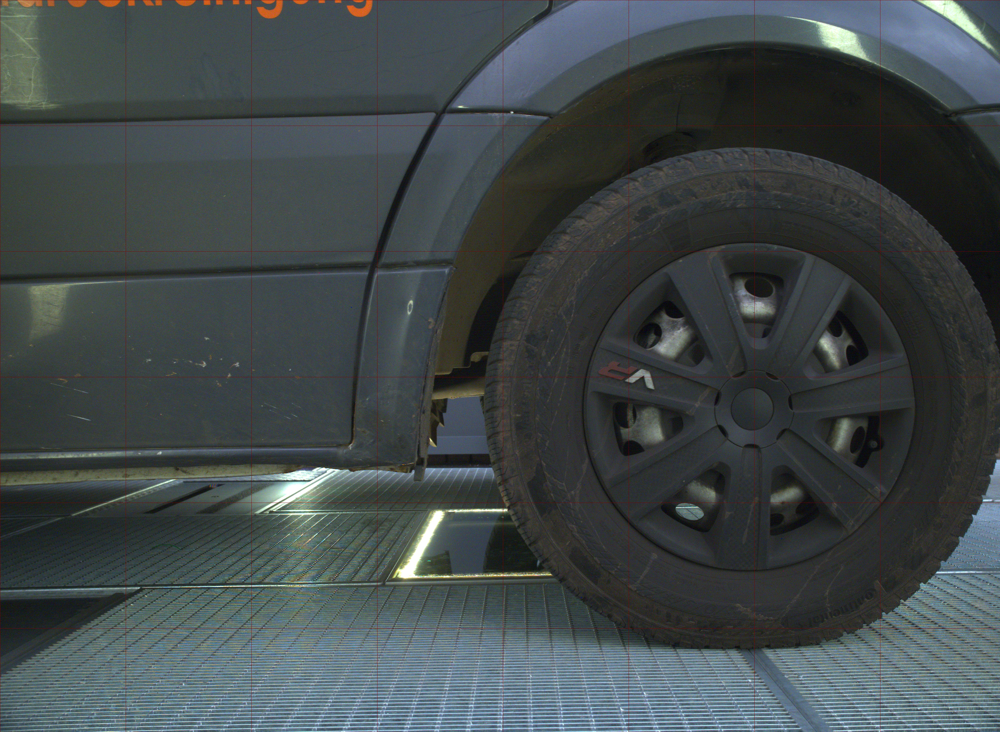

In [172]:
test_picture_grid = test_picture.copy()
draw = ImageDraw.Draw(test_picture_grid)
spacing = 515
for x in range(0, test_picture.width, spacing):
    vertical_line = ((x, 0), (x, test_picture.height))
    draw.line(vertical_line, fill=128)
for y in range(0, test_picture.height, spacing):
    horizontal_line = ((0, y), (test_picture.width, y))
    draw.line(horizontal_line, fill=128)
del draw

test_picture_grid         

In [102]:
im = np.array(test_picture)

In [103]:
im.shape

(3000, 4096, 3)

In [104]:
im = im[:, :4095]

In [48]:
im.shape

(3000, 4095, 3)

In [53]:
ims = im[np.arange(im.shape[0]).reshape(-1, 300), np.arange(im.shape[1]).reshape(-1, 315)]

IndexError: shape mismatch: indexing arrays could not be broadcast together with shapes (10,300) (13,315) 

In [24]:
ims.shape

(10, 14, 3)

In [33]:
xs = np.arange(im.shape[0]).reshape(-1, 300)
ys = np.arange(im.shape[1]).reshape(-1, 290)

ValueError: cannot reshape array of size 4096 into shape (290)

In [52]:
4095/315

13.0

In [173]:
ratio_list = [(x,y,i) for x in range(2080,3020) for y in range(4076, 5196) for i in range(450,550) if x%i == 0 and y%i == 0]

In [176]:
sorted(ratio_list, key=lambda x: np.sqrt(np.sum((3000-x[0])**2 + (4096-x[1])**2) + (500-x[2])**2))[:10]

[(2814, 4221, 469),
 (2820, 4230, 470),
 (2808, 4212, 468),
 (2826, 4239, 471),
 (2802, 4203, 467),
 (2832, 4248, 472),
 (2796, 4194, 466),
 (2838, 4257, 473),
 (2790, 4185, 465),
 (2844, 4266, 474)]

The input image size VGG19 is trained on is `224x224`, however, neither `3000` nor `4096` are divisible by 224 ! Since we want to make square blocks inside the original image, we have to resize the input image a bit. However, resizing it too aggressively would distort it and the network's filters might not be able to effectively be reused from their pre-training.

Hence, I suggest we look for the best compromise of distortion to the image height/width and block size.
To find the best, I computed a list of all possible values within acceptable ranges and then sorted them by their L2 distance to the optimal.

Here, we see that resizing the image to be `2814`x`4221` is the closest ratio to the original image, and a block size of `469` is not far off from the ideal `500` either.

In [178]:
# We'd have 6 blocks in width and 9 blocks in height
2814/469, 4221/469

(6.0, 9.0)

In [179]:
im = np.array(test_picture.resize((4221, 2814), Image.LANCZOS))

In [180]:
im.shape

(2814, 4221, 3)

In [181]:
# generates indices for the blocks
xs = np.arange(im.shape[0]).reshape(-1, 469) 
ys = np.arange(im.shape[1]).reshape(-1, 469)

In [182]:
ims = np.array([im[x][:, y] for x in xs for y in ys])

In [183]:
assert ims.shape == (6*9, 469, 469, 3)

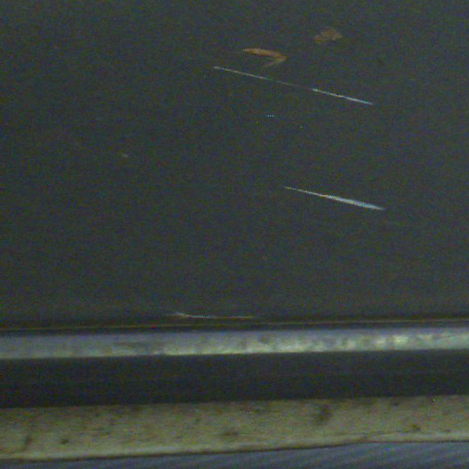

In [191]:
Image.fromarray(ims[27])

In [193]:
def chunkify(im_pil: Image, width: int, height: int, blocksize: int):
    """
        Cuts the image into blocksize**2 blocks of size blocksize*blocksize
    """
    assert width%blocksize == 0 and height%blocksize == 0
    im = np.array(test_picture.resize((width, height), Image.LANCZOS))
    # generates indices for the blocks
    xs = np.arange(im.shape[0]).reshape(-1, blocksize)
    ys = np.arange(im.shape[1]).reshape(-1, blocksize)
    return np.array([im[x][:, y] for x in xs for y in ys]) # TODO: find a way to circumvent the use of this for loop

def chunkify_np(im_np: np.array, width: int, height: int, blocksize: int):
    """
        Cuts the image into blocksize**2 blocks of size blocksize*blocksize
    """
    assert width%blocksize == 0 and height%blocksize == 0
    im = cv2.resize(im_np, dsize=(width, height), interpolation=cv2.INTER_LANCZOS4)
    # generates indices for the blocks
    xs = np.arange(im.shape[0]).reshape(-1, blocksize)
    ys = np.arange(im.shape[1]).reshape(-1, blocksize)
    return np.array([im[x][:, y] for x in xs for y in ys]) # TODO: find a way to circumvent the use of this for loop